In [97]:
import tensorflow as tf
from tensorflow.keras.models import Sequential
from tensorflow.keras.layers import Dense, Conv2D, Flatten, Dropout, MaxPooling2D
from tensorflow.keras.preprocessing.image import ImageDataGenerator
from sklearn.model_selection import train_test_split
import sklearn.model_selection
import matplotlib.image as mpimg
import matplotlib.pyplot as plt

import os
import numpy as np
from os import listdir
import shutil

tf.compat.v1.disable_eager_execution()

In [34]:
batch_size = 128
epochs = 15
IMG_HEIGHT = 150
IMG_WIDTH = 150
IMAGES_PATH = "../categorizer/images"
DATASET_PATH = "../dataset"
train_dir = DATASET_PATH + "/train"
validation_dir = DATASET_PATH + "/test"

In [13]:
import json

with open(IMAGES_PATH + '/categorised.json') as json_file:
    data = json.load(json_file)
    positive_images = data['categorised']['ass']
    total_files_number = data['page'] * 16


all_files_list = list(filter(lambda x: x.endswith(".jpg") , listdir(IMAGES_PATH)))
all_files_list.sort()
files_list = all_files_list[:total_files_number]
negative_images = [x for x in files_list if not x in positive_images]

print('total images number', total_files_number)
print('positive length', len(positive_images))
print('negative_images length', len(negative_images))
#print('files list\n', "\n".join(files_list[:20]))


total images number 8080
positive length 490
negative_images length 7629


In [44]:
%%time

notass_train = round(len(negative_images)*0.7)
ass_train = round(len(positive_images)*0.7)

for file in negative_images[:notass_train]:
    shutil.copyfile(IMAGES_PATH+"/"+file, DATASET_PATH+"/train/notass/"+file)
for file in negative_images[notass_train:]:
    shutil.copyfile(IMAGES_PATH+"/"+file, DATASET_PATH+"/test/notass/"+file)
    
for file in positive_images[:ass_train]:
    shutil.copyfile(IMAGES_PATH+"/"+file, DATASET_PATH+"/train/ass/"+file)
for file in positive_images[ass_train:]:
    shutil.copyfile(IMAGES_PATH+"/"+file, DATASET_PATH+"/test/ass/"+file)

total_train = notass_train + ass_train
total_val = len(negative_images) + len(positive_images) - total_train

print('total_train', total_train)
print('total_val', total_val)

total_train 5683
total_val 2436
CPU times: user 707 ms, sys: 3.38 s, total: 4.09 s
Wall time: 7.89 s


In [88]:
train_data_gen = ImageDataGenerator(rescale=1./255).flow_from_directory(batch_size=batch_size,
                                                           directory=train_dir,
                                                           shuffle=True,
                                                           target_size=(IMG_HEIGHT, IMG_WIDTH),
                                                           class_mode='binary')

val_data_gen = ImageDataGenerator(rescale=1./255).flow_from_directory(batch_size=batch_size,
                                                              directory=validation_dir,
                                                              target_size=(IMG_HEIGHT, IMG_WIDTH),
                                                              class_mode='binary',
                                                             shuffle=False)

Found 5683 images belonging to 2 classes.
Found 2436 images belonging to 2 classes.


In [75]:
# This function will plot images in the form of a grid with 1 row and 5 columns where images are placed in each column.
def plot_images(images_arr, rows=5, cols=5):
    fig, axes = plt.subplots(rows, cols, figsize=(20,20))
    axes = axes.flatten()
    for img, ax in zip( images_arr, axes):
        ax.imshow(img)
        ax.axis('off')
    plt.tight_layout()
    plt.show()
    
def plot_images_with_class(images_arr, y, start_ind=0, rows=5, cols=5):
    fig, axes = plt.subplots(rows, cols, figsize=(cols*4,rows*4))
    axes = axes.flatten()
    ind = 0
    for img, ax in zip( images_arr[start_ind:], axes):
        ax.imshow(img)
        ax.axis('off')
        ax.set_title('ASS' if y[start_ind+ind] == 1 else 'NOT ASS')
        ind +=1
    plt.tight_layout()
    plt.show()
    
def plot_files(files, rows=5, cols=5 ):
    images = map(lambda x: mpimg.imread(IMAGES_PATH + '/' + x), files[:rows*cols])
    plotImages(images, rows, cols)

def plot_file(file):
    plt.imshow(mpimg.imread(file))

In [1]:
#plotFiles(files_list)

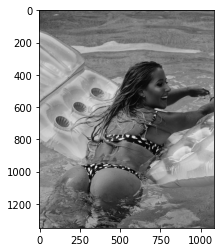

In [13]:
img = mpimg.imread(IMAGES_PATH + '/' + positive_images[100])
plt.imshow(img)


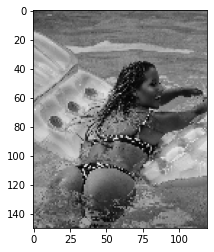

In [14]:
resized = tf.image.resize(
    img, [IMG_HEIGHT, IMG_WIDTH], method= tf.image.ResizeMethod.NEAREST_NEIGHBOR, preserve_aspect_ratio=True,
    antialias=False
)
plt.imshow(resized.numpy())

In [103]:
model = Sequential([
    Conv2D(16, 3, padding='same', activation='relu', input_shape=(IMG_HEIGHT, IMG_WIDTH ,3)),
    MaxPooling2D(),
    Conv2D(32, 3, padding='same', activation='relu'),
    MaxPooling2D(),
    Conv2D(64, 3, padding='same', activation='relu'),
    MaxPooling2D(),
    Flatten(),
    Dense(512, activation='relu'),
    Dense(1)
])
model.summary()

Model: "sequential_7"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
conv2d_11 (Conv2D)           (None, 150, 150, 16)      448       
_________________________________________________________________
max_pooling2d_9 (MaxPooling2 (None, 75, 75, 16)        0         
_________________________________________________________________
conv2d_12 (Conv2D)           (None, 75, 75, 32)        4640      
_________________________________________________________________
max_pooling2d_10 (MaxPooling (None, 37, 37, 32)        0         
_________________________________________________________________
conv2d_13 (Conv2D)           (None, 37, 37, 64)        18496     
_________________________________________________________________
max_pooling2d_11 (MaxPooling (None, 18, 18, 64)        0         
_________________________________________________________________
flatten_7 (Flatten)          (None, 20736)            

In [46]:
my_model = Sequential([
    Flatten(input_shape=(IMG_HEIGHT, IMG_WIDTH ,3)),
    Dense(units=256, activation='relu'),
    Dense(units=128, activation='relu'),
    Dense(units=64, activation='relu'),
    Dense(units=32, activation='relu'),
    Dense(units=16, activation='relu'),
    Dense(units=10, activation='softmax')
])
my_model.summary()

Model: "sequential_4"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
flatten_4 (Flatten)          (None, 67500)             0         
_________________________________________________________________
dense_20 (Dense)             (None, 256)               17280256  
_________________________________________________________________
dense_21 (Dense)             (None, 128)               32896     
_________________________________________________________________
dense_22 (Dense)             (None, 64)                8256      
_________________________________________________________________
dense_23 (Dense)             (None, 32)                2080      
_________________________________________________________________
dense_24 (Dense)             (None, 16)                528       
_________________________________________________________________
dense_25 (Dense)             (None, 10)               

In [164]:
%%time
def reshape(x):
    return tf.image.resize(
        x, [IMG_HEIGHT, IMG_WIDTH], method= tf.image.ResizeMethod.BILINEAR, preserve_aspect_ratio=False,
        antialias=False,
    )/255.0

X = np.array(list(map(lambda x: reshape(mpimg.imread(IMAGES_PATH + '/' + x)), files_list[:5])))

CPU times: user 29 s, sys: 87.6 ms, total: 29.1 s
Wall time: 29.2 s


In [39]:
Y = list(map(lambda x: 1 if x in positive_images else 0, files_list))
x_train, x_test_val, y_train, y_test_val = train_test_split(X, Y)
x_test, x_validate, y_test, y_validate = train_test_split(x_test_val, y_test_val)
print(len(x_train), len(y_train))
print(len(x_test), len(y_test))
print(len(x_validate), len(y_validate))

NameError: name 'X' is not defined

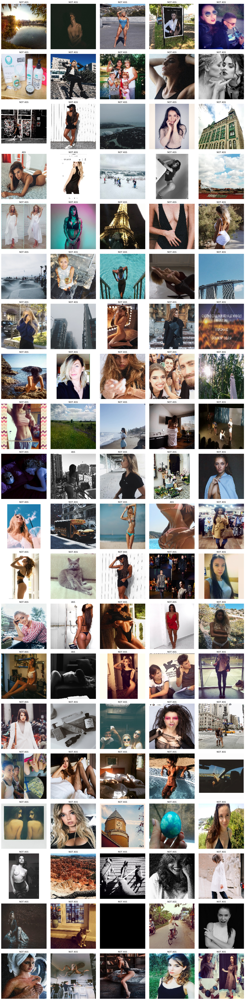

In [134]:
plot_images_with_class(x_validate, y_validate, start_ind=0, rows=20, cols=5)

In [102]:

model.compile(optimizer='adam',
              loss=tf.keras.losses.BinaryCrossentropy(from_logits=True),
              metrics=['accuracy'])
model.fit(x_train, y_train, epochs=1, validation_data=(x_test, y_test))

NameError: name 'x_train' is not defined

In [99]:
model.compile(optimizer='adam',
              loss=tf.keras.losses.BinaryCrossentropy(from_logits=True),
              metrics=['accuracy'])

history = model.fit_generator(
    train_data_gen,
    steps_per_epoch=total_train // batch_size,
    epochs=1,
    validation_data=val_data_gen,
    validation_steps=total_val // batch_size
)

Instructions for updating:
If using Keras pass *_constraint arguments to layers.


ValueError: Calling `Model.fit` in graph mode is not supported when the `Model` instance was constructed with eager mode enabled. Please construct your `Model` instance in graph mode or call `Model.fit` with eager mode enabled.

In [48]:
my_model.compile(optimizer='adam',
              loss=tf.keras.losses.BinaryCrossentropy(from_logits=True),
              metrics=['accuracy'])

history = my_model.fit_generator(
    train_data_gen,
    steps_per_epoch=total_train // batch_size,
    epochs=1,
    validation_data=val_data_gen,
    validation_steps=total_val // batch_size
)

ValueError: in user code:

    /Users/atomin/.pyenv/versions/3.8.2/lib/python3.8/site-packages/tensorflow/python/keras/engine/training.py:571 train_function  *
        outputs = self.distribute_strategy.run(
    /Users/atomin/.pyenv/versions/3.8.2/lib/python3.8/site-packages/tensorflow/python/distribute/distribute_lib.py:951 run  **
        return self._extended.call_for_each_replica(fn, args=args, kwargs=kwargs)
    /Users/atomin/.pyenv/versions/3.8.2/lib/python3.8/site-packages/tensorflow/python/distribute/distribute_lib.py:2290 call_for_each_replica
        return self._call_for_each_replica(fn, args, kwargs)
    /Users/atomin/.pyenv/versions/3.8.2/lib/python3.8/site-packages/tensorflow/python/distribute/distribute_lib.py:2649 _call_for_each_replica
        return fn(*args, **kwargs)
    /Users/atomin/.pyenv/versions/3.8.2/lib/python3.8/site-packages/tensorflow/python/keras/engine/training.py:532 train_step  **
        loss = self.compiled_loss(
    /Users/atomin/.pyenv/versions/3.8.2/lib/python3.8/site-packages/tensorflow/python/keras/engine/compile_utils.py:205 __call__
        loss_value = loss_obj(y_t, y_p, sample_weight=sw)
    /Users/atomin/.pyenv/versions/3.8.2/lib/python3.8/site-packages/tensorflow/python/keras/losses.py:143 __call__
        losses = self.call(y_true, y_pred)
    /Users/atomin/.pyenv/versions/3.8.2/lib/python3.8/site-packages/tensorflow/python/keras/losses.py:246 call
        return self.fn(y_true, y_pred, **self._fn_kwargs)
    /Users/atomin/.pyenv/versions/3.8.2/lib/python3.8/site-packages/tensorflow/python/keras/losses.py:1595 binary_crossentropy
        K.binary_crossentropy(y_true, y_pred, from_logits=from_logits), axis=-1)
    /Users/atomin/.pyenv/versions/3.8.2/lib/python3.8/site-packages/tensorflow/python/keras/backend.py:4682 binary_crossentropy
        return nn.sigmoid_cross_entropy_with_logits(labels=target, logits=output)
    /Users/atomin/.pyenv/versions/3.8.2/lib/python3.8/site-packages/tensorflow/python/ops/nn_impl.py:171 sigmoid_cross_entropy_with_logits
        raise ValueError("logits and labels must have the same shape (%s vs %s)" %

    ValueError: logits and labels must have the same shape ((None, 10) vs (None, 1))


In [90]:
val_data_gen.reset()
batch = val_data_gen.next()

In [94]:
batch1=val_data_gen.next()

In [98]:
list(zip(model.predict(batch[0]), batch[1]))

ValueError: Calling `Model.predict` in graph mode is not supported when the `Model` instance was constructed with eager mode enabled. Please construct your `Model` instance in graph mode or call `Model.predict` with eager mode enabled.

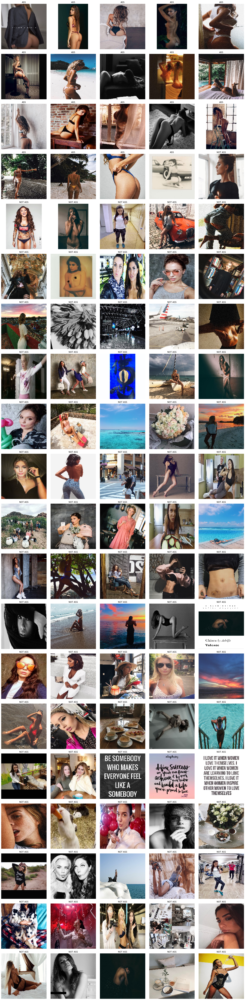

In [95]:
plot_images_with_class(batch1[0], 1-batch1[1], rows=20)

In [84]:
val_data_gen.filenames

['ass/2017-08-20_22-01-24_UTC.jpg',
 'ass/2017-08-22_04-09-59_UTC.jpg',
 'ass/2017-08-22_16-18-15_UTC.jpg',
 'ass/2017-08-23_08-50-09_UTC.jpg',
 'ass/2017-08-26_14-38-05_UTC.jpg',
 'ass/2017-08-28_10-54-02_UTC.jpg',
 'ass/2017-08-28_17-41-18_UTC.jpg',
 'ass/2017-08-28_20-52-23_UTC.jpg',
 'ass/2017-08-29_11-06-41_UTC.jpg',
 'ass/2017-08-29_18-26-59_UTC.jpg',
 'ass/2017-08-30_06-02-18_UTC.jpg',
 'ass/2017-08-30_13-14-15_UTC.jpg',
 'ass/2017-08-30_14-36-36_UTC.jpg',
 'ass/2017-09-01_16-01-38_UTC.jpg',
 'ass/2017-09-04_02-05-15_UTC.jpg',
 'ass/2017-09-04_15-28-39_UTC.jpg',
 'ass/2017-09-05_19-31-54_UTC.jpg',
 'ass/2017-09-06_17-00-32_UTC.jpg',
 'ass/2017-09-09_16-19-17_UTC.jpg',
 'ass/2017-09-10_00-41-13_UTC.jpg',
 'ass/2017-09-11_08-21-39_UTC.jpg',
 'ass/2017-09-14_15-30-45_UTC.jpg',
 'ass/2017-09-15_01-36-27_UTC.jpg',
 'ass/2017-09-16_00-18-18_UTC.jpg',
 'ass/2017-09-16_07-00-52_UTC.jpg',
 'ass/2017-09-16_08-02-25_UTC.jpg',
 'ass/2017-09-16_09-27-18_UTC.jpg',
 'ass/2017-09-16_15-17-14_UT

In [96]:
model.predict(batch1[0])

array([[25.7364    ],
       [ 7.097903  ],
       [ 7.715699  ],
       [ 8.368403  ],
       [16.030552  ],
       [-1.8861374 ],
       [-7.220059  ],
       [ 5.2557855 ],
       [ 6.9579144 ],
       [15.493484  ],
       [ 4.575433  ],
       [ 7.327058  ],
       [ 7.9710326 ],
       [27.351051  ],
       [-1.633975  ],
       [34.543224  ],
       [ 0.7039795 ],
       [15.281534  ],
       [ 9.377482  ],
       [15.8763485 ],
       [14.856794  ],
       [ 1.1474421 ],
       [13.281637  ],
       [ 7.070088  ],
       [14.518215  ],
       [13.960685  ],
       [ 7.9542236 ],
       [30.744316  ],
       [13.058739  ],
       [29.73603   ],
       [28.926958  ],
       [36.99316   ],
       [40.59892   ],
       [ 9.6938095 ],
       [ 3.024734  ],
       [12.249886  ],
       [18.150944  ],
       [33.604862  ],
       [-0.8164325 ],
       [ 4.966566  ],
       [21.330551  ],
       [ 6.274722  ],
       [ 2.6316464 ],
       [18.25386   ],
       [32.852512  ],
       [19